In [3]:
# Install Ultralytics library
!pip install ultralytics

In [5]:
# Disable warnings in the notebook to maintain clean output cells
import warnings
warnings.filterwarnings('ignore')

# Import necessary libraries
import os
import shutil
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import cv2
import yaml
from PIL import Image
from ultralytics import YOLO
from IPython.display import Video

In [2]:
# Configure the visual appearance of Seaborn plots
sns.set(rc={'axes.facecolor': '#eae8fa'}, style='darkgrid')

In [3]:
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('yolov8n.pt')


image 1/1 /Users/aishwaryanalawade/Spectra/Label_studio_dataset/train/images/f15a33b6-15_mp4-12_jpg.rf.1f65bc481957ccc0786c4cc7b62b6264.jpg: 640x640 1 bus, 92.3ms
Speed: 2.8ms preprocess, 92.3ms inference, 6.2ms postprocess per image at shape (1, 3, 640, 640)


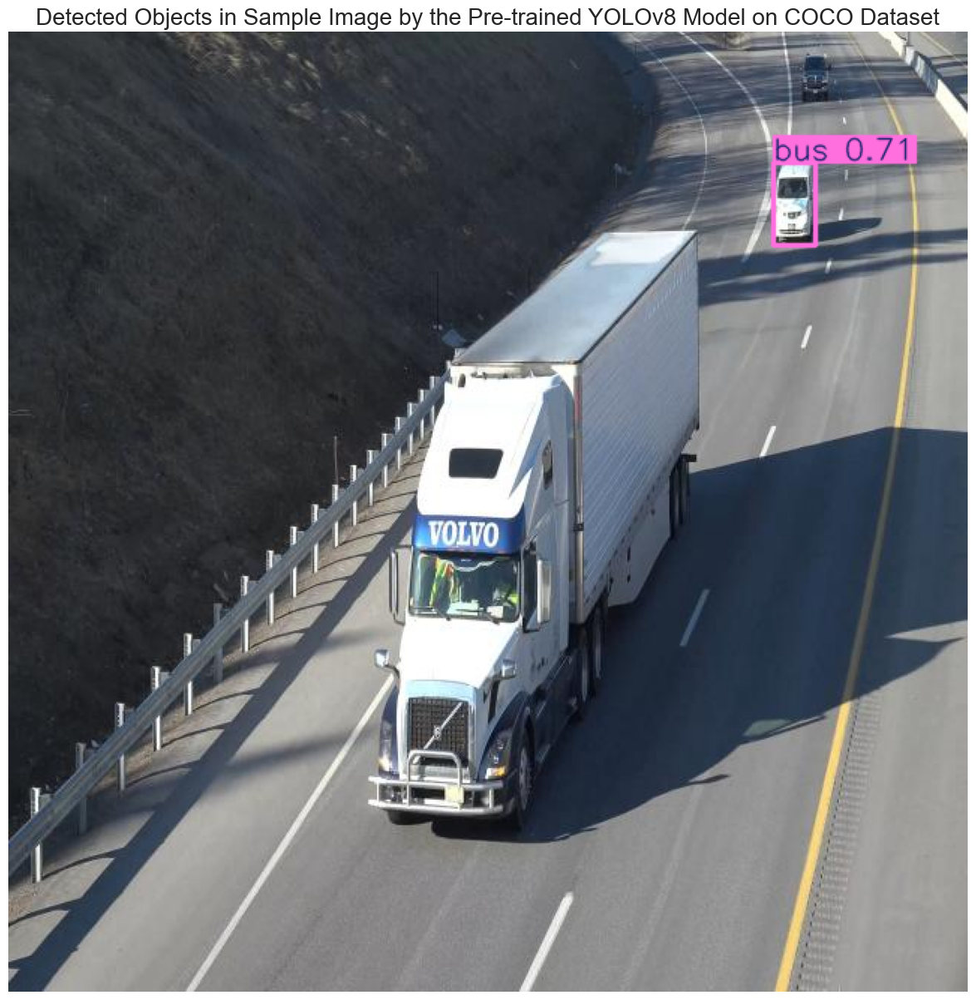

In [6]:
# Path to the image file
image_path ='/Users/aishwaryanalawade/Spectra/Label_studio_dataset/train/images/f15a33b6-15_mp4-12_jpg.rf.1f65bc481957ccc0786c4cc7b62b6264.jpg'

# Perform inference on the provided image(s)
results = model.predict(source=image_path, 
                        imgsz=640,  # Resize image to 640x640 (the size pf images the model was trained on)
                        conf=0.5)   # Confidence threshold: 50% (only detections above 50% confidence will be considered)

# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Pre-trained YOLOv8 Model on COCO Dataset', fontsize=20)
plt.axis('off')
plt.show()

In [7]:
import os

def filter_yolo_labels(input_dir, output_dir, allowed_classes={0, 1, 2, 3}):
    """
    Filters YOLOv8 label files, keeping only specified class IDs and saves them to output directory.
    
    :param input_dir: Directory containing YOLOv8 label files (.txt)
    :param output_dir: Directory to save filtered label files
    :param allowed_classes: Set of class IDs to keep
    """
    os.makedirs(output_dir, exist_ok=True)
    
    for filename in os.listdir(input_dir):
        if filename.endswith(".txt"):
            input_file_path = os.path.join(input_dir, filename)
            output_file_path = os.path.join(output_dir, filename)
            
            with open(input_file_path, "r") as f:
                lines = f.readlines()
            
            filtered_lines = [line for line in lines if int(line.split()[0]) in allowed_classes]
            
            with open(output_file_path, "w") as f:
                f.writelines(filtered_lines)

# Example usage
input_directory = '/Users/aishwaryanalawade/Spectra/Label_studio_dataset/train/old_labels'
output_directory = '/Users/aishwaryanalawade/Spectra/Label_studio_dataset/train/labels'
filter_yolo_labels(input_directory, output_directory)


In [10]:
import os

def filter_yolo_labels(input_dir, output_dir, allowed_classes={0, 1, 2, 3}):
    """
    Filters YOLOv8 label files, keeping only specified class IDs and saves them to output directory.
    
    :param input_dir: Directory containing YOLOv8 label files (.txt)
    :param output_dir: Directory to save filtered label files
    :param allowed_classes: Set of class IDs to keep
    """
    os.makedirs(output_dir, exist_ok=True)
    
    for filename in os.listdir(input_dir):
        if filename.endswith(".txt"):
            input_file_path = os.path.join(input_dir, filename)
            output_file_path = os.path.join(output_dir, filename)
            
            with open(input_file_path, "r") as f:
                lines = f.readlines()
            
            filtered_lines = [line for line in lines if int(line.split()[0]) in allowed_classes]
            
            with open(output_file_path, "w") as f:
                f.writelines(filtered_lines)

# Example usage
input_directory = '/Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/labels_with_color'
output_directory = '/Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/labels'
filter_yolo_labels(input_directory, output_directory)


In [9]:
import os
import yaml

# Define the dataset_path
dataset_path = '/Users/aishwaryanalawade/Spectra/Label_studio_dataset'

# Set the path to the YAML file
yaml_file_path = os.path.join(dataset_path, 'data.yaml')

# Load and print the contents of the YAML file
with open(yaml_file_path, 'r') as file:
    yaml_content = yaml.load(file, Loader=yaml.FullLoader)
    print(yaml.dump(yaml_content, default_flow_style=False))


names:
  0: car
  1: motorcycle
  2: bus
  3: truck
nc: 4
train: ../train/images
val: ../valid/images



In [11]:
import os
from PIL import Image  # Import Image module from PIL

# Set paths for training and validation image sets
dataset_path = '/Users/aishwaryanalawade/Spectra/Label_studio_dataset'
train_images_path = os.path.join(dataset_path, 'train', 'images')
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# Initialize counters for the number of images
num_train_images = 0
num_valid_images = 0

# Initialize sets to hold the unique sizes of images
train_image_sizes = set()
valid_image_sizes = set()

# Check train images sizes and count
for filename in os.listdir(train_images_path):
    if filename.endswith('.jpg'):  
        num_train_images += 1
        image_path = os.path.join(train_images_path, filename)
        with Image.open(image_path) as img:
            train_image_sizes.add(img.size)

# Check validation images sizes and count
for filename in os.listdir(valid_images_path):
    if filename.endswith('.jpg'): 
        num_valid_images += 1
        image_path = os.path.join(valid_images_path, filename)
        with Image.open(image_path) as img:
            valid_image_sizes.add(img.size)

# Print the results
print(f"Number of training images: {num_train_images}")
print(f"Number of validation images: {num_valid_images}")

# Check if all images in training set have the same size
if len(train_image_sizes) == 1:
    print(f"All training images have the same size: {train_image_sizes.pop()}")
else:
    print("Training images have varying sizes.")

# Check if all images in validation set have the same size
if len(valid_image_sizes) == 1:
    print(f"All validation images have the same size: {valid_image_sizes.pop()}")
else:
    print("Validation images have varying sizes")


Number of training images: 446
Number of validation images: 90
All training images have the same size: (640, 640)
All validation images have the same size: (640, 640)


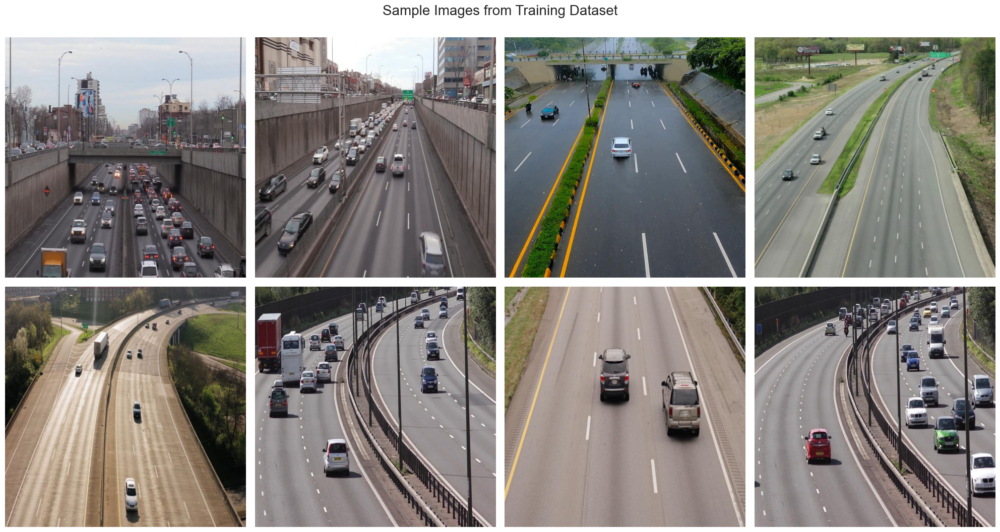

In [9]:
# List all jpg images in the directory
image_files = [file for file in os.listdir(train_images_path) if file.endswith('.jpg')]

# Select 8 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 8)]

# Create a 2x4 subplot
fig, axes = plt.subplots(2, 4, figsize=(20, 11))

# Display each of the selected images
for ax, img_file in zip(axes.ravel(), selected_images):
    img_path = os.path.join(train_images_path, img_file)
    image = Image.open(img_path)
    ax.imshow(image)
    ax.axis('off')  

plt.suptitle('Sample Images from Training Dataset', fontsize=20)
plt.tight_layout()
plt.show()

In [10]:
pip install -U ipywidgets

Note: you may need to restart the kernel to use updated packages.


In [11]:
pip install -U ultralytics ray

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 64.9/64.9 MB 3.1 MB/s eta 0:00:0000:0100:01
  Attempting uninstall: ray
    Found existing installation: ray 2.41.0
    Uninstalling ray-2.41.0:
      Successfully uninstalled ray-2.41.0
Note: you may need to restart the kernel to use updated packages.


In [12]:
pip install --upgrade ray

Note: you may need to restart the kernel to use updated packages.


In [16]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=30,              # Number of epochs to train for
    imgsz=640,               # Size of input images as integer
    device='cpu',                # Device to run on, i.e. cuda device=0 
    patience=7,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate 
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.1,             # Use dropout regularization
    seed=0                   # Random seed for reproducibility
)

Ultralytics 8.3.70 🚀 Python-3.9.21 torch-2.6.0 CPU (Apple M1)
engine/trainer: task=detect, mode=train, model=yolov8n.pt, data=/Users/aishwaryanalawade/Spectra/Label_studio_dataset/data.yaml, epochs=30, time=None, patience=7, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train2, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_labels=True, show_conf=T

train: Scanning /Users/aishwaryanalawade/Spectra/Label_studio_dataset/train/labe
val: Scanning /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/labels

Plotting labels to runs/detect/train2/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train2
Starting training for 30 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/30         0G      1.616      3.597      1.134        332        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885     0.0247      0.581      0.128     0.0575



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/30         0G      1.599      1.808      1.089        275        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885     0.0381      0.658      0.265      0.141



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/30         0G      1.539      1.517      1.121        371        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.819      0.167      0.226      0.126



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/30         0G      1.538      1.398      1.121        353        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.864     0.0893      0.293      0.159



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/30         0G      1.506      1.293      1.109        401        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.595     0.0785      0.266      0.144



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/30         0G      1.519      1.269       1.11        403        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.872      0.191      0.382      0.203



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/30         0G      1.487      1.237      1.114        365        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.559      0.231      0.335      0.175



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/30         0G      1.488      1.206      1.113        343        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.418      0.393      0.374      0.194



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/30         0G      1.511      1.189      1.126        429        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.602      0.337      0.389      0.202



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/30         0G      1.505      1.136      1.115        261        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.492       0.46      0.485      0.237



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/30         0G      1.477       1.12      1.123        353        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.659       0.52      0.594      0.292



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/30         0G      1.499      1.151      1.115        374        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.529       0.67      0.574       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/30         0G      1.484       1.11      1.118        401        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.496      0.541      0.528       0.29



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/30         0G       1.45      1.067      1.109        307        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.513      0.637       0.55      0.295



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/30         0G      1.455      1.064      1.104        495        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885       0.45      0.493      0.514      0.277



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/30         0G      1.447      1.063      1.107        200        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.535      0.638       0.52       0.28



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/30         0G      1.473      1.058      1.093        369        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.513      0.652       0.56      0.286



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/30         0G      1.446      1.038      1.102        331        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.658      0.693      0.659      0.332



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/30         0G      1.434      1.006      1.098        410        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.603      0.593      0.617      0.305



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/30         0G      1.406     0.9941      1.084        330        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.554      0.687       0.61       0.32


Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/30         0G      1.451      1.011      1.115        266        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.614      0.629      0.648      0.331



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/30         0G      1.432     0.9818      1.111        227        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.533      0.701      0.593      0.318



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/30         0G      1.439     0.9721      1.108        231        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.654       0.62      0.637      0.333



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/30         0G       1.43     0.9608      1.121        239        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.639      0.717      0.626      0.327



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/30         0G      1.429     0.9537      1.118        159        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.627      0.703      0.685      0.341



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/30         0G      1.402     0.9297        1.1        305        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.621      0.702      0.626      0.329



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/30         0G      1.391     0.9117      1.093        254        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.593      0.684      0.608      0.313



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/30         0G      1.406     0.9082        1.1        180        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.641      0.685      0.664      0.347



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/30         0G      1.399     0.9132        1.1        259        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.641      0.719      0.671      0.336



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/30         0G      1.383     0.8944      1.092        201        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.641      0.751      0.673      0.355



30 epochs completed in 2.330 hours.
Optimizer stripped from runs/detect/train2/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train2/weights/best.pt, 6.2MB

Validating runs/detect/train2/weights/best.pt...
Ultralytics 8.3.70 🚀 Python-3.9.21 torch-2.6.0 CPU (Apple M1)
Model summary (fused): 168 layers, 3,006,428 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         90        885       0.64      0.751      0.669      0.353
                   car         82        685      0.739      0.888      0.853       0.49
            motorcycle         19         26      0.595      0.654      0.494      0.227
                   bus         10         16      0.594      0.733      0.653      0.334
                 truck         68        158      0.634      0.728      0.678      0.359
Speed: 1.1ms preprocess, 161.8ms inference, 0.0ms loss, 0.7ms postprocess per image
Results saved to runs/detect/train2


In [17]:
# Define the path to the directory
post_training_files_path = '/Users/aishwaryanalawade/Spectra/runs/detect/train2'

# List the files in the directory
!ls {post_training_files_path}

F1_curve.png                    train_batch0.jpg
PR_curve.png                    train_batch1.jpg
P_curve.png                     train_batch2.jpg
R_curve.png                     train_batch280.jpg
args.yaml                       train_batch281.jpg
confusion_matrix.png            train_batch282.jpg
confusion_matrix_normalized.png val_batch0_labels.jpg
labels.jpg                      val_batch0_pred.jpg
labels_correlogram.jpg          val_batch1_labels.jpg
results.csv                     val_batch1_pred.jpg
results.png                     weights


In [18]:
# Define a function to plot learning curves for loss values
def plot_learning_curve(df, train_loss_col, val_loss_col, title):
    plt.figure(figsize=(12, 5))
    sns.lineplot(data=df, x='epoch', y=train_loss_col, label='Train Loss', color='#141140', linestyle='-', linewidth=2)
    sns.lineplot(data=df, x='epoch', y=val_loss_col, label='Validation Loss', color='orangered', linestyle='--', linewidth=2)
    plt.title(title)
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.show()

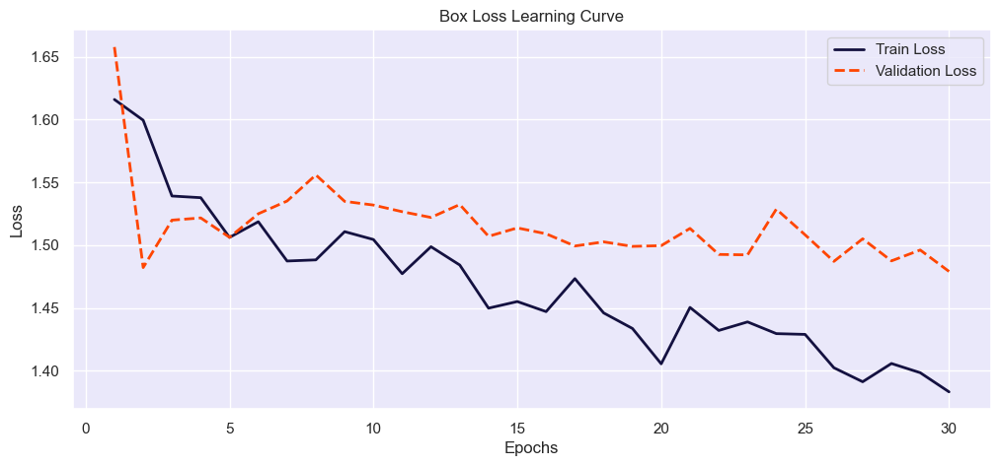

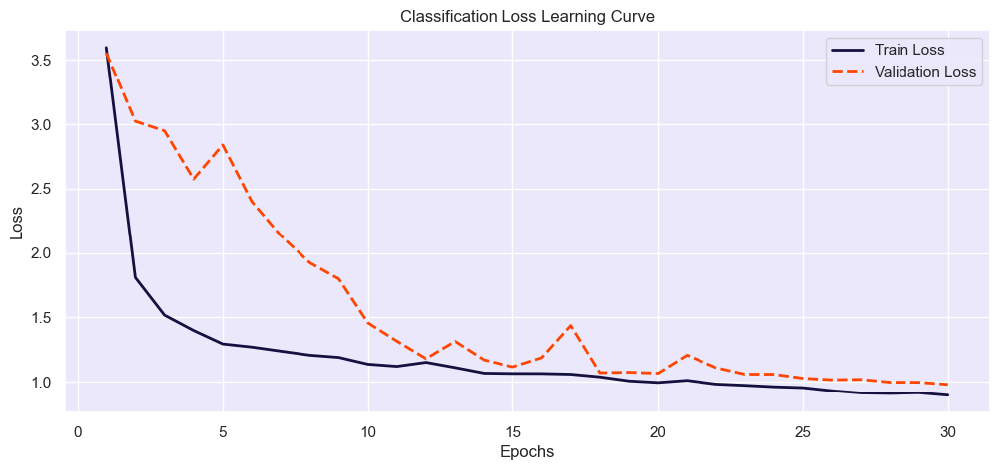

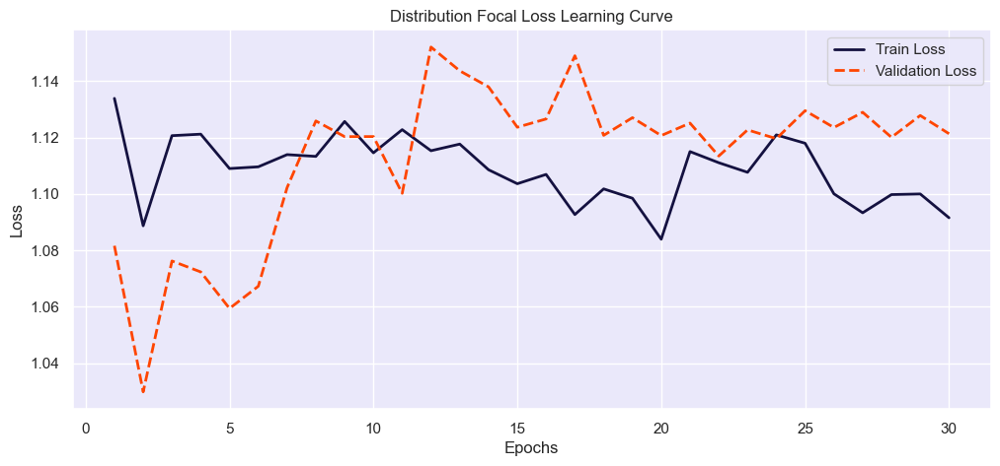

In [19]:
# Create the full file path for 'results.csv' using the directory path and file name
results_csv_path = os.path.join(post_training_files_path, 'results.csv')

# Load the CSV file from the constructed path into a pandas DataFrame
df = pd.read_csv(results_csv_path)

# Remove any leading whitespace from the column names
df.columns = df.columns.str.strip()

# Plot the learning curves for each loss
plot_learning_curve(df, 'train/box_loss', 'val/box_loss', 'Box Loss Learning Curve')
plot_learning_curve(df, 'train/cls_loss', 'val/cls_loss', 'Classification Loss Learning Curve')
plot_learning_curve(df, 'train/dfl_loss', 'val/dfl_loss', 'Distribution Focal Loss Learning Curve')

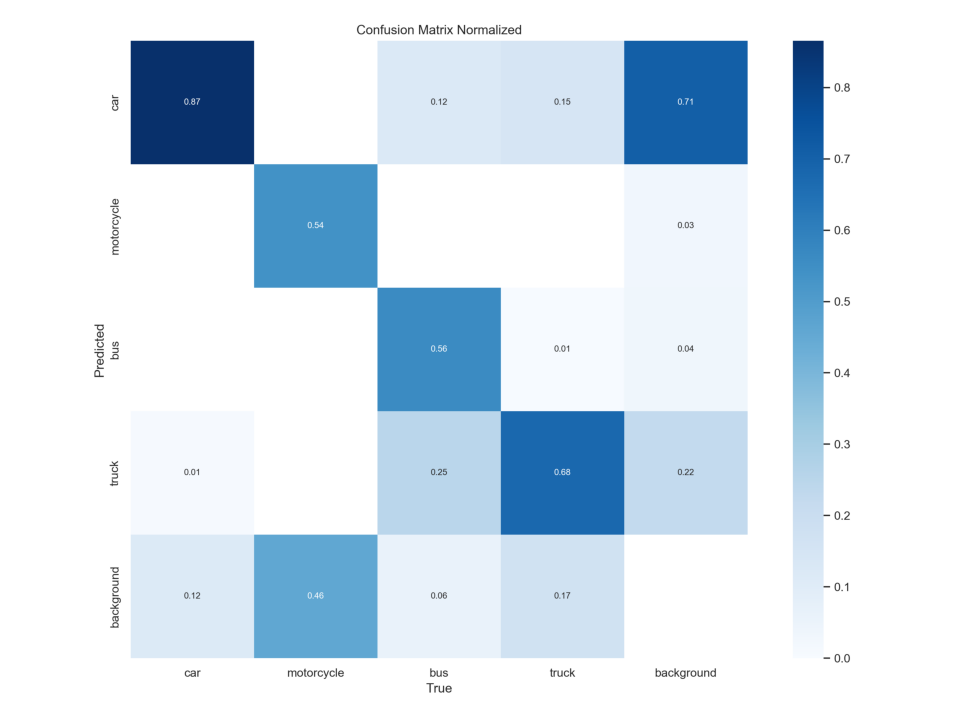

In [20]:
# Construct the path to the normalized confusion matrix image
confusion_matrix_path = os.path.join(post_training_files_path, 'confusion_matrix_normalized.png')

# Read the image using cv2
cm_img = cv2.imread(confusion_matrix_path)

# Convert the image from BGR to RGB color space for accurate color representation with matplotlib
cm_img = cv2.cvtColor(cm_img, cv2.COLOR_BGR2RGB)

# Display the image
plt.figure(figsize=(10, 10), dpi=120)
plt.imshow(cm_img)
plt.axis('off') 
plt.show()

In [21]:
# Construct the path to the best model weights file using os.path.join
best_model_path = os.path.join(post_training_files_path, 'weights/best.pt')

# Load the best model weights into the YOLO model
best_model = YOLO(best_model_path)

# Validate the best model using the validation set with default parameters
metrics = best_model.val(split='val')

Ultralytics 8.3.70 🚀 Python-3.9.21 torch-2.6.0 CPU (Apple M1)
Model summary (fused): 168 layers, 3,006,428 parameters, 0 gradients, 8.1 GFLOPs


val: Scanning /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/labels
                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         90        885       0.64      0.751      0.669      0.353
                   car         82        685      0.739      0.888      0.853       0.49
            motorcycle         19         26      0.595      0.654      0.494      0.227
                   bus         10         16      0.594      0.733      0.653      0.334
                 truck         68        158      0.634      0.728      0.678      0.359
Speed: 1.2ms preprocess, 165.3ms inference, 0.0ms loss, 0.6ms postprocess per image
Results saved to runs/detect/val


In [22]:
# Convert the dictionary to a pandas DataFrame and use the keys as the index
metrics_df = pd.DataFrame.from_dict(metrics.results_dict, orient='index', columns=['Metric Value'])

# Display the DataFrame
metrics_df.round(3)

,Metric Value
metrics/precision(B),0.640
metrics/recall(B),0.751
metrics/mAP50(B),0.669
metrics/mAP50-95(B),0.353
fitness,0.384



image 1/1 /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/images/d9856576-6_mp4-0_jpg.rf.9a055d040151678e04cb48a8bde76f55.jpg: 640x640 2 cars, 1 truck, 70.2ms
Speed: 1.1ms preprocess, 70.2ms inference, 1.4ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/images/1f6d5ebb-6_mp4-10_jpg.rf.4e74eb10d5dc733c083cdf4f227386ab.jpg: 640x640 1 car, 2 trucks, 65.8ms
Speed: 0.8ms preprocess, 65.8ms inference, 0.3ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/images/d7da1d8a-7_mp4-6_jpg.rf.3f9214d14313fa7dd572e7739bbe7398.jpg: 640x640 5 cars, 71.6ms
Speed: 1.5ms preprocess, 71.6ms inference, 0.6ms postprocess per image at shape (1, 3, 640, 640)

image 1/1 /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/images/e145cc8f-14_mp4-2_jpg.rf.2f13b98e9712d8b5bef0b7b419a376b2.jpg: 640x640 3 cars, 1 truck, 58.9ms
Speed: 0.8ms preprocess, 58.

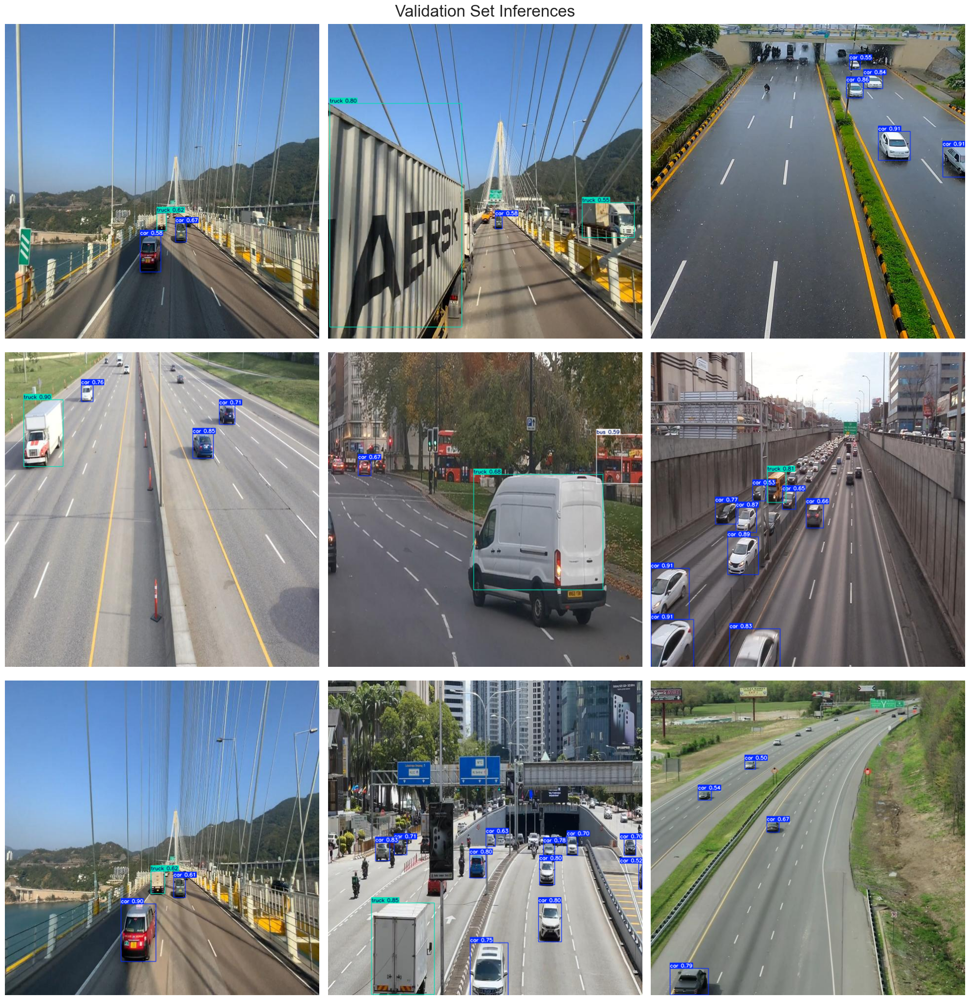

In [23]:
# Define the path to the validation images
valid_images_path = os.path.join(dataset_path, 'valid', 'images')

# List all jpg images in the directory
image_files = [file for file in os.listdir(valid_images_path) if file.endswith('.jpg')]

# Select 9 images at equal intervals
num_images = len(image_files)
selected_images = [image_files[i] for i in range(0, num_images, num_images // 9)]

# Initialize the subplot
fig, axes = plt.subplots(3, 3, figsize=(20, 21))
fig.suptitle('Validation Set Inferences', fontsize=24)

# Perform inference on each selected image and display it
for i, ax in enumerate(axes.flatten()):
    image_path = os.path.join(valid_images_path, selected_images[i])
    results = best_model.predict(source=image_path, imgsz=640, conf=0.5)
    annotated_image = results[0].plot(line_width=1)
    annotated_image_rgb = cv2.cvtColor(annotated_image, cv2.COLOR_BGR2RGB)
    ax.imshow(annotated_image_rgb)
    ax.axis('off')

plt.tight_layout()
plt.show()



image 1/1 /Users/aishwaryanalawade/Desktop/road4.jpeg: 448x640 2 cars, 75.0ms
Speed: 3.0ms preprocess, 75.0ms inference, 0.6ms postprocess per image at shape (1, 3, 448, 640)


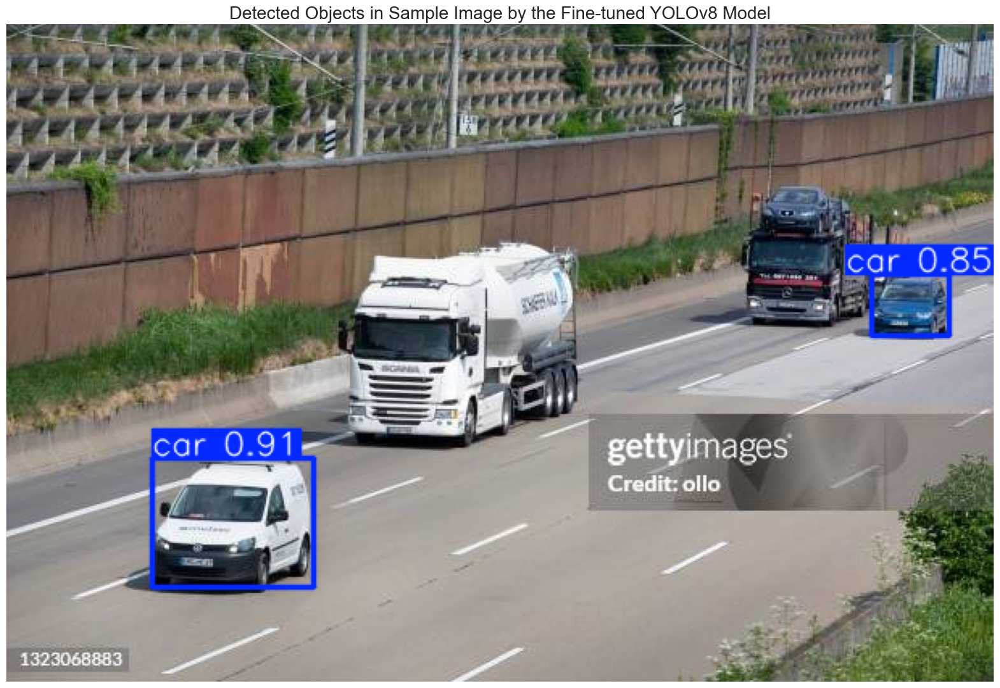

In [24]:
# Path to the image file
sample_image_path = '/Users/aishwaryanalawade/Desktop/road4.jpeg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/aishwaryanalawade/Desktop/road6.jpeg: 448x640 4 cars, 1 truck, 76.8ms
Speed: 5.0ms preprocess, 76.8ms inference, 0.5ms postprocess per image at shape (1, 3, 448, 640)


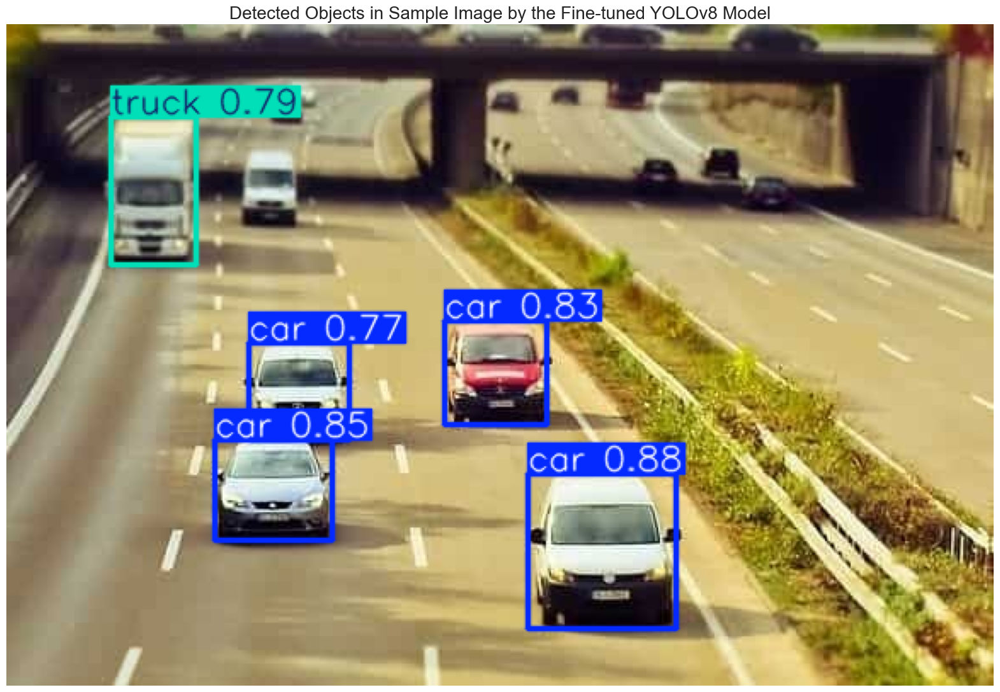

In [26]:
# Path to the image file
sample_image_path = '/Users/aishwaryanalawade/Desktop/road6.jpeg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/aishwaryanalawade/Desktop/road5.jpeg: 384x640 5 cars, 61.8ms
Speed: 2.6ms preprocess, 61.8ms inference, 0.3ms postprocess per image at shape (1, 3, 384, 640)


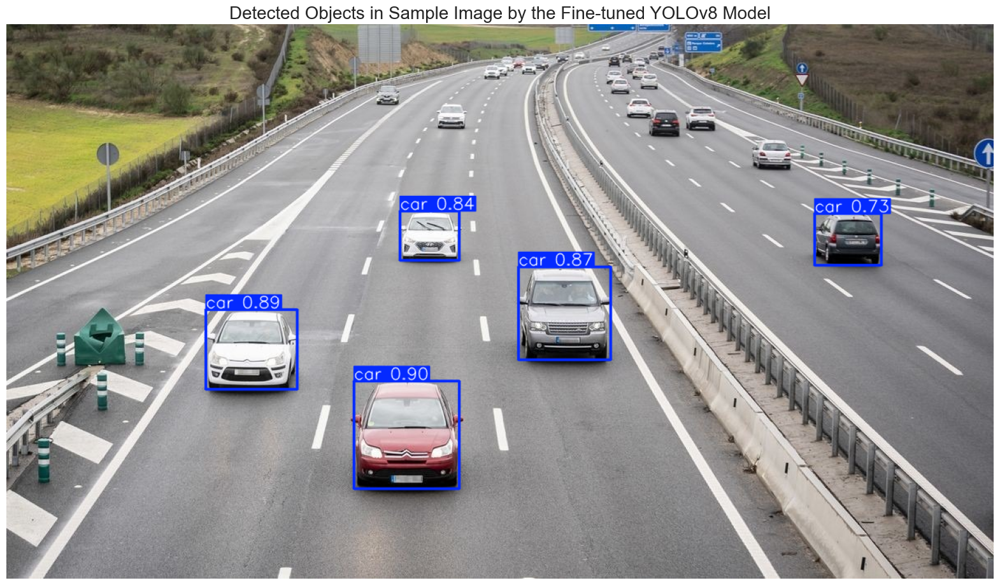

In [27]:
# Path to the image file
sample_image_path = '/Users/aishwaryanalawade/Desktop/road5.jpeg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/aishwaryanalawade/Desktop/road2.jpeg: 544x640 2 cars, 1 truck, 76.3ms
Speed: 7.1ms preprocess, 76.3ms inference, 0.4ms postprocess per image at shape (1, 3, 544, 640)


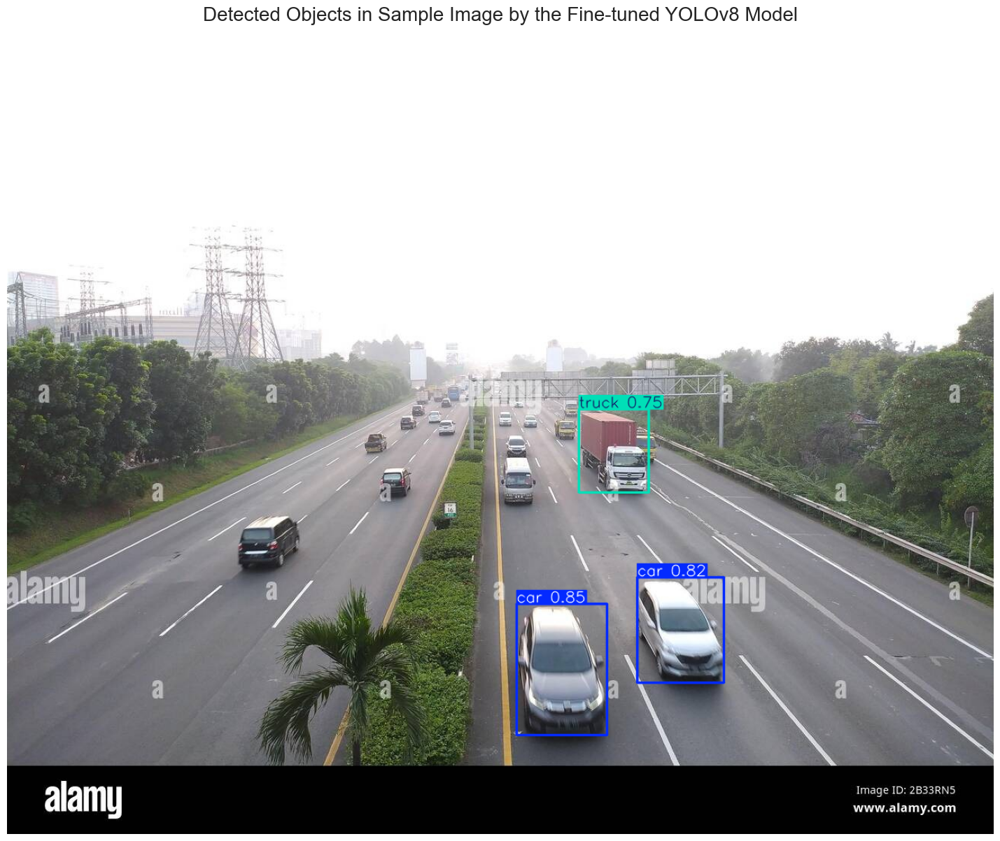

In [28]:
# Path to the image file
sample_image_path = '/Users/aishwaryanalawade/Desktop/road2.jpeg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()


image 1/1 /Users/aishwaryanalawade/Desktop/input1.jpeg: 640x416 5 cars, 58.0ms
Speed: 3.3ms preprocess, 58.0ms inference, 0.4ms postprocess per image at shape (1, 3, 640, 416)


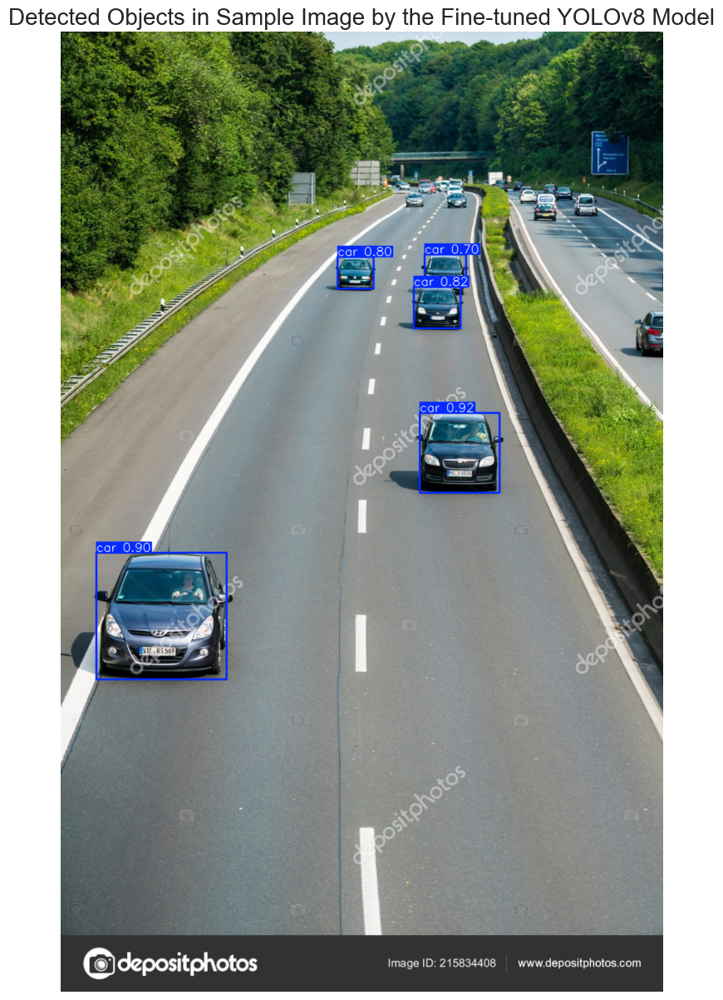

In [29]:
# Path to the image file
sample_image_path = '/Users/aishwaryanalawade/Desktop/input1.jpeg'

# Perform inference on the provided image using best model
results = best_model.predict(source=sample_image_path, imgsz=640, conf=0.7) 
                        
# Annotate and convert image to numpy array
sample_image = results[0].plot(line_width=2)

# Convert the color of the image from BGR to RGB for correct color representation in matplotlib
sample_image = cv2.cvtColor(sample_image, cv2.COLOR_BGR2RGB)

# Display annotated image
plt.figure(figsize=(20,15))
plt.imshow(sample_image)
plt.title('Detected Objects in Sample Image by the Fine-tuned YOLOv8 Model', fontsize=20)
plt.axis('off')
plt.show()

In [7]:
# Load a pretrained YOLOv8n model from Ultralytics
model = YOLO('/Users/aishwaryanalawade/Spectra/runs/detect/train2/weights/best.pt')

In [13]:
# Train the model on our custom dataset
results = model.train(
    data=yaml_file_path,     # Path to the dataset configuration file
    epochs=10,              # Number of epochs to train for
    imgsz=640,               # Size of input images as integer
    device='cpu',                # Device to run on, i.e. cuda device=0 
    patience=3,             # Epochs to wait for no observable improvement for early stopping of training
    batch=32,                # Number of images per batch
    optimizer='auto',        # Optimizer to use, choices=[SGD, Adam, Adamax, AdamW, NAdam, RAdam, RMSProp, auto]
    lr0=0.0001,              # Initial learning rate 
    lrf=0.1,                 # Final learning rate (lr0 * lrf)
    dropout=0.1,             # Use dropout regularization
    seed=0                   # Random seed for reproducibility
)

New https://pypi.org/project/ultralytics/8.3.72 available 😃 Update with 'pip install -U ultralytics'
Ultralytics 8.3.70 🚀 Python-3.9.21 torch-2.6.0 CPU (Apple M1)
engine/trainer: task=detect, mode=train, model=/Users/aishwaryanalawade/Spectra/runs/detect/train2/weights/best.pt, data=/Users/aishwaryanalawade/Spectra/Label_studio_dataset/data.yaml, epochs=10, time=None, patience=3, batch=32, imgsz=640, save=True, save_period=-1, cache=False, device=cpu, workers=8, project=None, name=train3, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.1, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False

train: Scanning /Users/aishwaryanalawade/Spectra/Label_studio_dataset/train/labe
val: Scanning /Users/aishwaryanalawade/Spectra/Label_studio_dataset/valid/labels

Plotting labels to runs/detect/train3/labels.jpg... 


optimizer: 'optimizer=auto' found, ignoring 'lr0=0.0001' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.00125, momentum=0.9) with parameter groups 57 weight(decay=0.0), 64 weight(decay=0.0005), 63 bias(decay=0.0)
Image sizes 640 train, 640 val
Using 0 dataloader workers
Logging results to runs/detect/train3
Starting training for 10 epochs...
Closing dataloader mosaic

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/10         0G      1.378     0.8762        1.1        238        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885       0.68       0.65      0.649      0.337



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/10         0G      1.374     0.8791      1.087        280        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.603      0.717      0.632      0.334



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/10         0G      1.412      0.898      1.106        203        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.567      0.744      0.625      0.321



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/10         0G       1.41      0.916      1.104        227        640: 1
                 Class     Images  Instances      Box(P          R      mAP50  m

                   all         90        885      0.628       0.65      0.619      0.316
EarlyStopping: Training stopped early as no improvement observed in last 3 epochs. Best results observed at epoch 1, best model saved as best.pt.
To update EarlyStopping(patience=3) pass a new patience value, i.e. `patience=300` or use `patience=0` to disable EarlyStopping.



4 epochs completed in 0.262 hours.
Optimizer stripped from runs/detect/train3/weights/last.pt, 6.2MB
Optimizer stripped from runs/detect/train3/weights/best.pt, 6.2MB

Validating runs/detect/train3/weights/best.pt...
Ultralytics 8.3.70 🚀 Python-3.9.21 torch-2.6.0 CPU (Apple M1)
Model summary (fused): 168 layers, 3,006,428 parameters, 0 gradients, 8.1 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  m


                   all         90        885       0.68      0.651      0.649      0.337
                   car         82        685      0.813        0.8       0.86      0.499
            motorcycle         19         26      0.612      0.486      0.491      0.207
                   bus         10         16       0.57      0.688      0.576      0.279
                 truck         68        158      0.724      0.631      0.668      0.363
Speed: 1.0ms preprocess, 144.2ms inference, 0.0ms loss, 0.5ms postprocess per image
Results saved to runs/detect/train3
